In [2]:
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

In [81]:
import sys
sys.path.append("..")
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")

from copy import deepcopy
import matplotlib.pyplot as plt
import numpy as np

from coordination.model.real.vocalic_2d import VocalicModel
from coordination.model.config_bundle.vocalic import Vocalic2DConfigBundle
from coordination.module.coordination.sigmoid_gaussian_coordination import SigmoidGaussianCoordinationSamples
from coordination.model.model import ModelSamples
from coordination.common.normalization import (normalize_serialized_data_per_feature,
                                               normalize_serialized_data_per_subject_and_feature)
from coordination.inference.inference_data import InferenceData

In [82]:
# Functions
def plot_state_space(samples: ModelSamples):
    subject_indices = samples.component_group_samples["state_space"].subject_indices[0]
    values = samples.component_group_samples["state_space"].values[0]
    fig, axs = plt.subplots(1, 2, figsize=(15,4))	
    for subject in range(3):
        ts = np.array([t for t, s in enumerate(subject_indices) if s == subject])
        ys = values[:, ts]
        axs[0].plot(ts, ys[0], label=f"Subject {subject + 1}", marker="o")
        axs[1].plot(ts, ys[1], label=f"Subject {subject + 1}", marker="o")

    axs[0].set_title("Position")
    axs[1].set_title("Speed")
    plt.legend()
    plt.tight_layout()

def plot_observations(samples: ModelSamples):
    subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
    values = samples.component_group_samples["speech_vocalics"].values[0]
    fig, axs = plt.subplots(2, 2, figsize=(15,8))	
    axs = axs.flatten()
    for i, feature_name in enumerate(["pitch", "intensity", "jitter", "shimmer"]):
        for subject in range(3):
            ts = np.array([t for t, s in enumerate(subject_indices) if s == subject])
            ys = values[:, ts]
            axs[i].plot(ts, ys[i], label=f"Subject {subject + 1}", marker="o")
            axs[i].set_title(feature_name)
    plt.legend()
    plt.tight_layout()   

def configure_model(num_time_steps: int, coordination: float, noise: float) -> VocalicModel:
    bundle = Vocalic2DConfigBundle()
    bundle.num_time_steps_in_coordination_scale = num_time_steps
    bundle.sd_a = noise
    bundle.sd_o = noise
    bundle.weights = [np.array([[1, 5, 10, 15]])] # different scale per feature
    bundle.mean_a0 = np.array([[0,1], [25,5], [50,10]])  # Start at different positions and with different speeds
    bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1, num_time_steps)) * coordination)
    return VocalicModel(bundle)    

def update_config_bundle_from_samples(config_bundle: Vocalic2DConfigBundle, samples: ModelSamples):
    config_bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0]
    config_bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
    config_bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
    config_bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
    config_bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]

def train(model: VocalicModel) -> InferenceData:
    model.clear_parameter_values()
    model.prepare_for_inference()
    model.create_random_variables()
    idata = model.fit(burn_in=10, num_samples=10)
    idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
    idata.plot_parameter_posterior()
    print(idata.generate_convergence_summary())
    return idata

# Sampling

## Coordination = 0

In the abcensse of coordination, each subject's component follows it's own dynamics which consists of a constant speed and position governed by a simple movement equation. See, for instance, that the position of the component from subject 3 increases faster than the others given its larger speed.

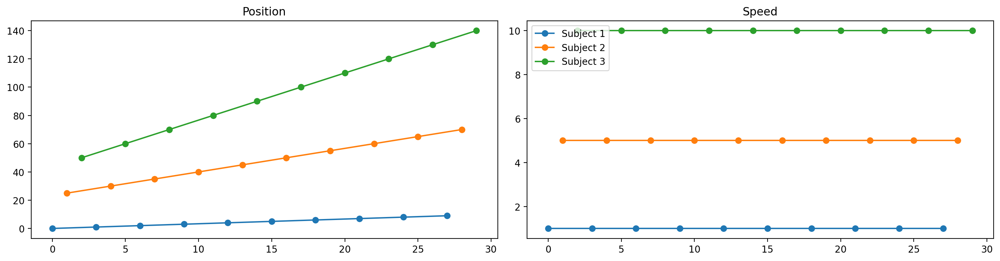

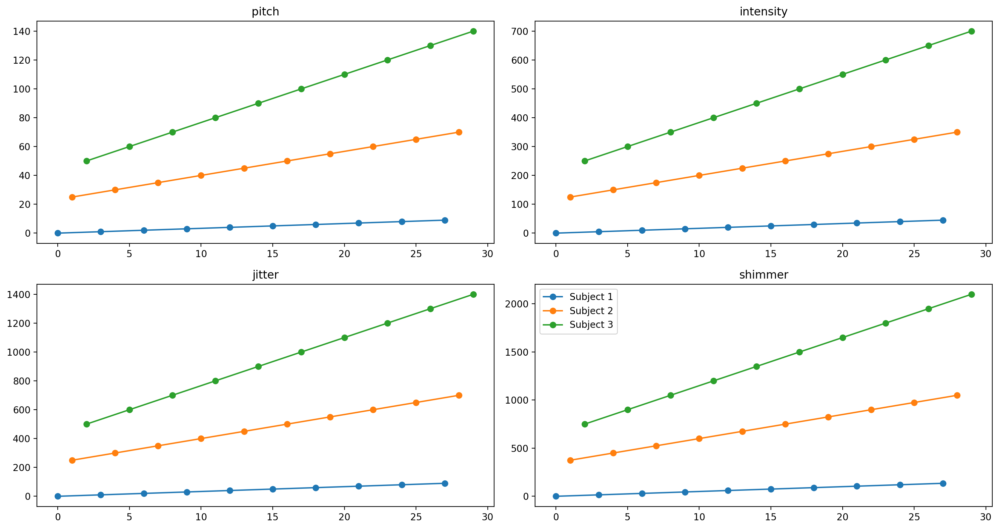

In [50]:
model = configure_model(
    num_time_steps=30,
    coordination=0,
    noise=0
)
model.prepare_for_sampling()
samples = model.draw_samples()
plot_state_space(samples)
plot_observations(samples)

## Coordination = 1

When coordination is maximum, the components instantly share the same speed which is a positive number in this example, leading to a constant increase in their position over time. Notice, however, that because we do not blend position, each component moves in its own scale, which would be equivalent to different people having different baselines for their biological signals. For instance, person A may have a natural lower picth than person B. Coordination will unlikely make person B to adopt person's B pitch but it may influence person A to increase their pitch with respect to person A's baseline if person B does the same with respect to their own pitch baseline.

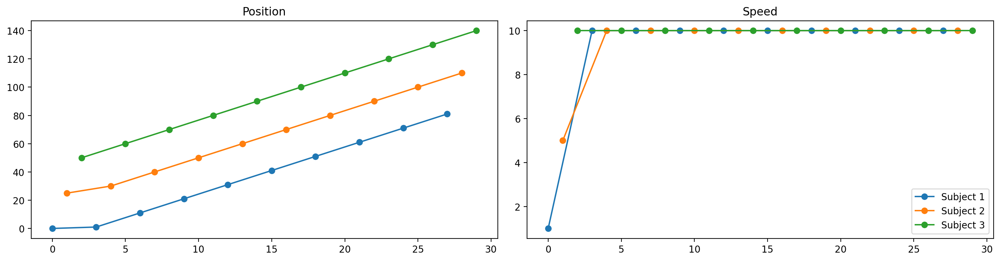

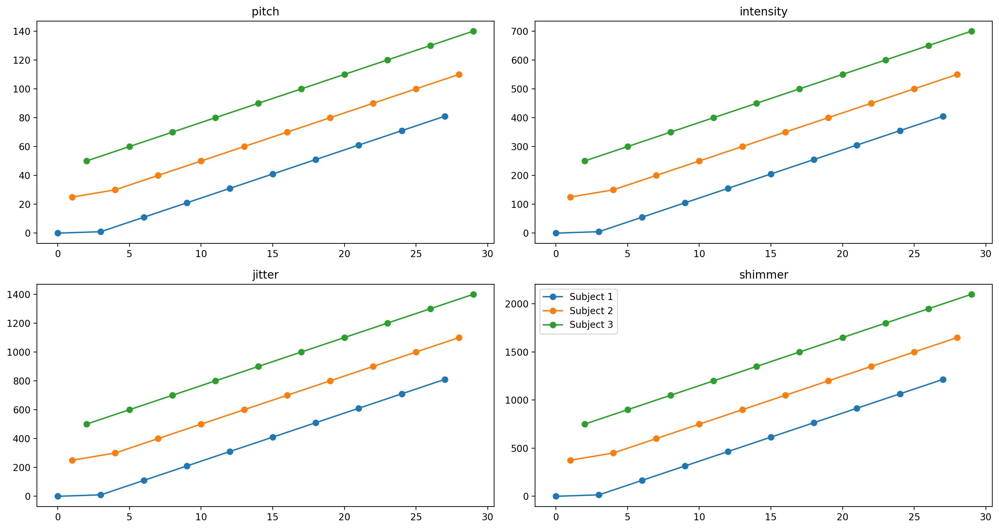

In [51]:
model = configure_model(
    num_time_steps=30,
    coordination=1,
    noise=0
)
model.prepare_for_sampling()
samples = model.draw_samples()
plot_state_space(samples)
plot_observations(samples)

## Coordination = 0.2

As we lower coordination, the slower the component's speed converge to a common value but it still does if coordination persists. This tells us that persistent non-zero coordination in this model leads to convergence given enough time and no noise in the system. There's probably an analytical form to find the time when the speeds converge given some conditions (no variance, no gaps etc.).

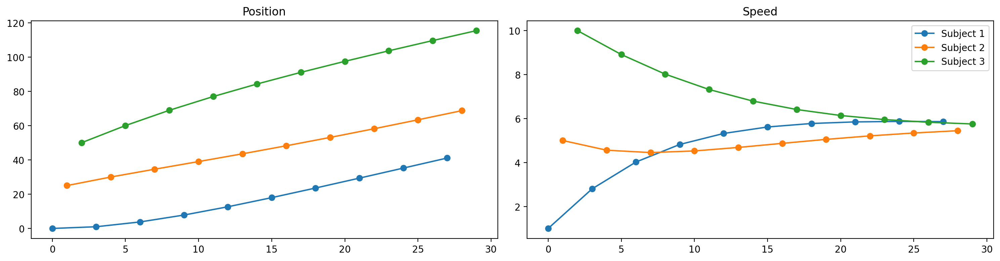

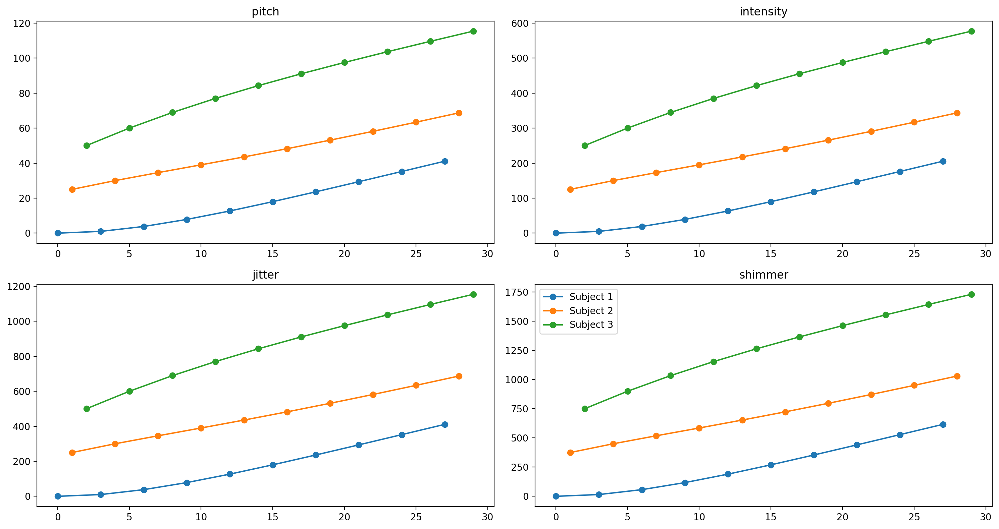

In [52]:
model = configure_model(
    num_time_steps=30,
    coordination=0.2,
    noise=0
)
model.prepare_for_sampling()
samples = model.draw_samples()
plot_state_space(samples)
plot_observations(samples)

# Normalization

In [72]:
model = configure_model(
    num_time_steps=30,
    coordination=0.2,
    noise=0
)
model.prepare_for_sampling()
samples = model.draw_samples()

## No normalization

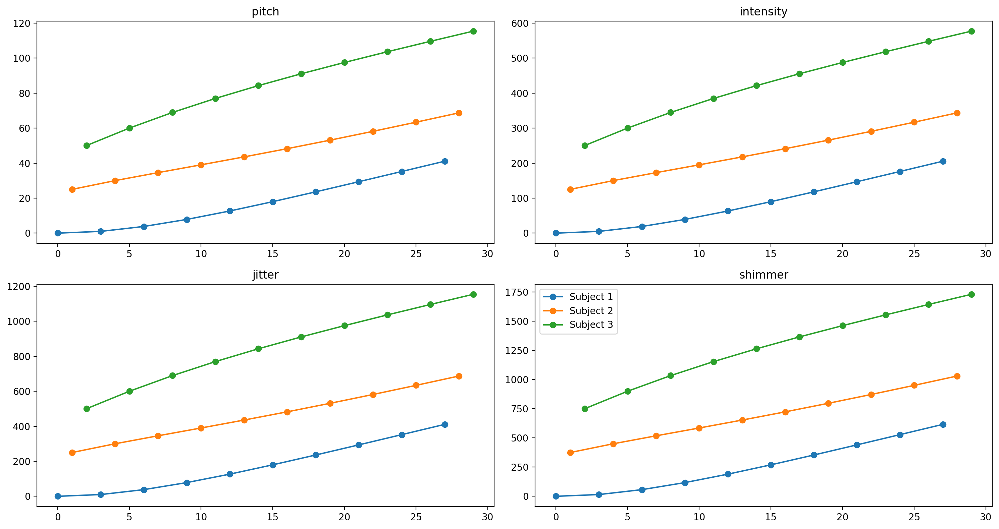

In [73]:
plot_observations(samples)

## Normalization per feature

This normalization does not distort the data trend but adjusts each feature to smaller, shared range.

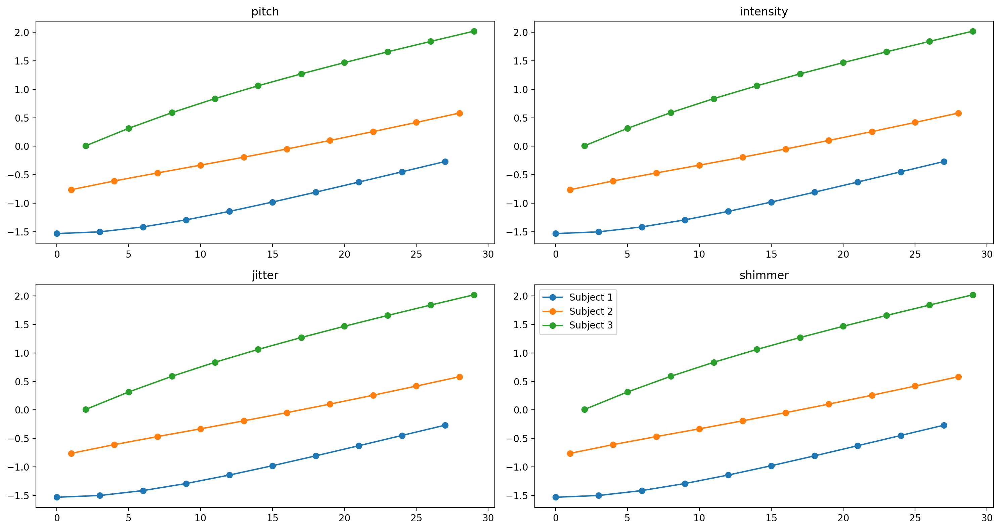

In [74]:
samples_copy = deepcopy(samples)
samples_copy.component_group_samples["speech_vocalics"].values[0] = normalize_serialized_data_per_feature(
    data = samples_copy.component_group_samples["speech_vocalics"].values[0])
plot_observations(samples_copy)

## Normalization per subject and feature

This type of normalization distorts data and should be avoided. Instead, we should fit different mean_a0 per subject to account for interpersonal differences.

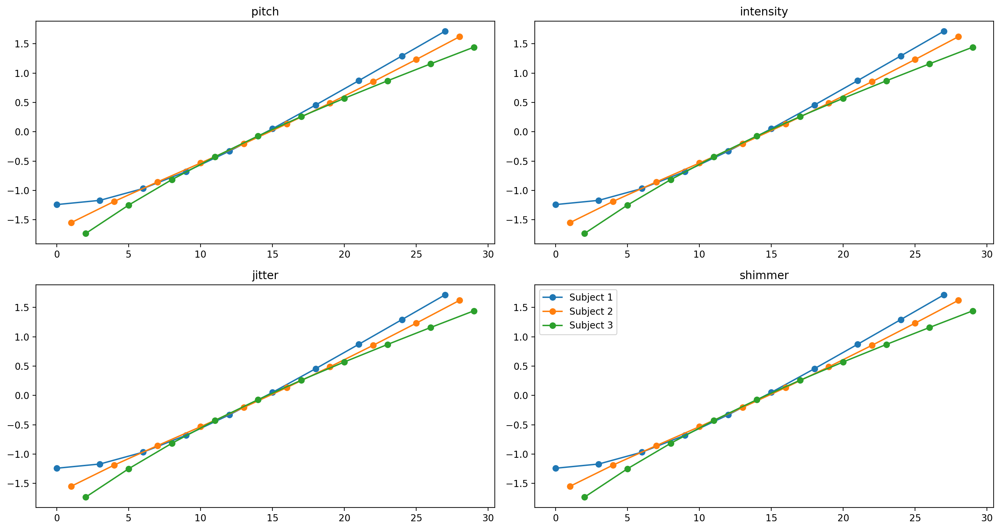

In [75]:
samples_copy = deepcopy(samples)
samples_copy.component_group_samples["speech_vocalics"].values[0] = normalize_serialized_data_per_subject_and_feature(
    data = samples_copy.component_group_samples["speech_vocalics"].values[0],
    subject_indices= samples_copy.component_group_samples["speech_vocalics"].subject_indices[0],
    num_subjects=3)
plot_observations(samples_copy)

# Inference

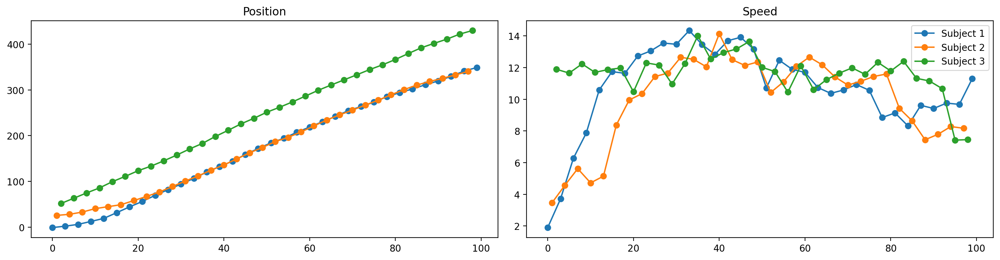

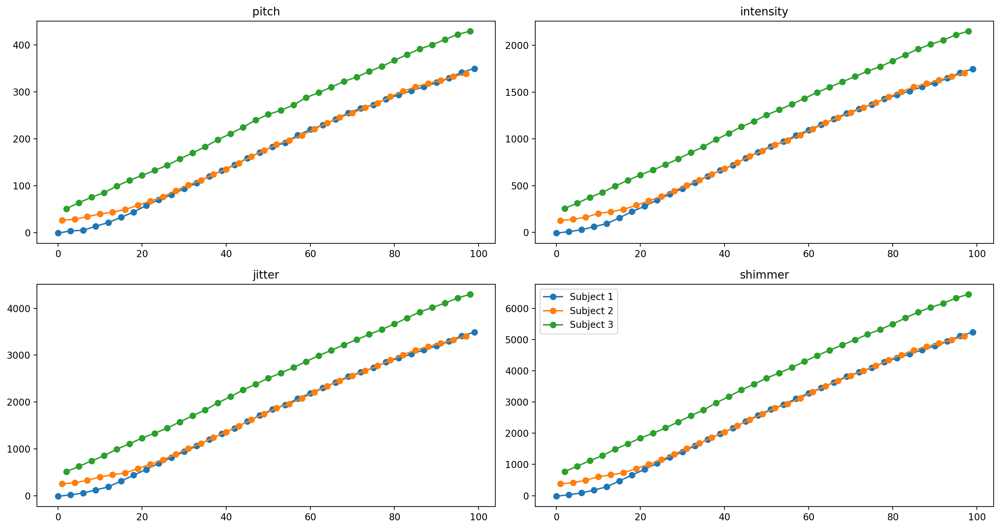

In [77]:
model = configure_model(
    num_time_steps=100,
    coordination=0.2,
    noise=1
)
model.prepare_for_sampling()
samples = model.draw_samples()
update_config_bundle_from_samples(model.config_bundle, samples)

plot_state_space(samples)
plot_observations(samples)

## Normalized data

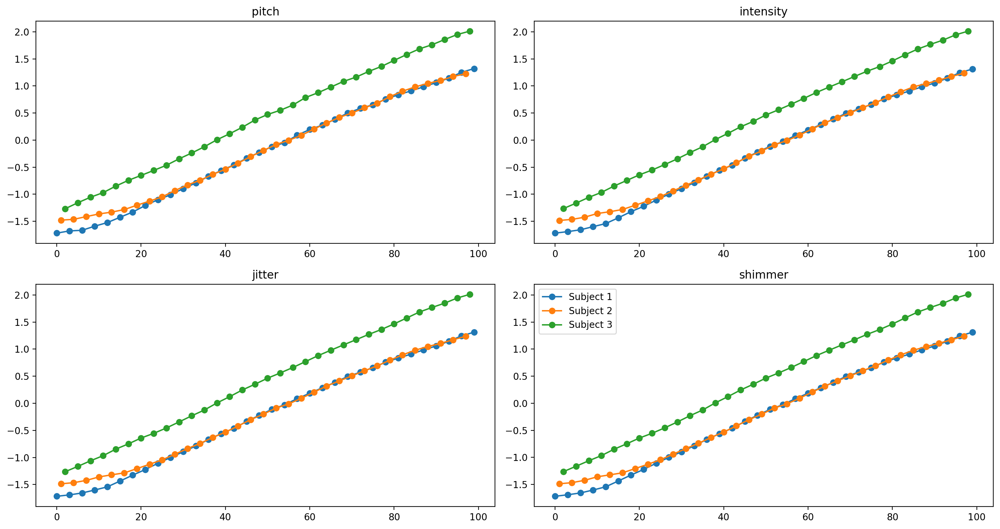

In [78]:
samples_copy = deepcopy(samples)
samples_copy.component_group_samples["speech_vocalics"].values[0] = normalize_serialized_data_per_feature(
    data = samples_copy.component_group_samples["speech_vocalics"].values[0])
plot_observations(samples_copy)

## No given parameters

Only 10 samples in chain.
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 10 tune and 10 draw iterations (40 + 40 draws total) took 38 seconds.


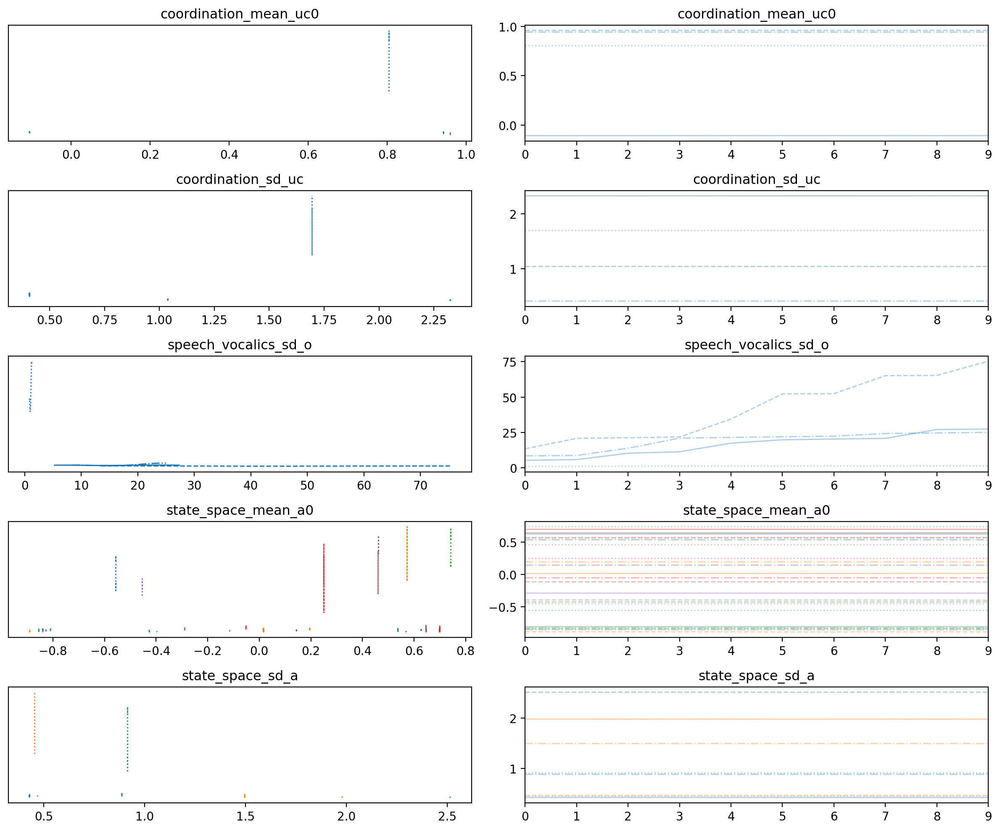

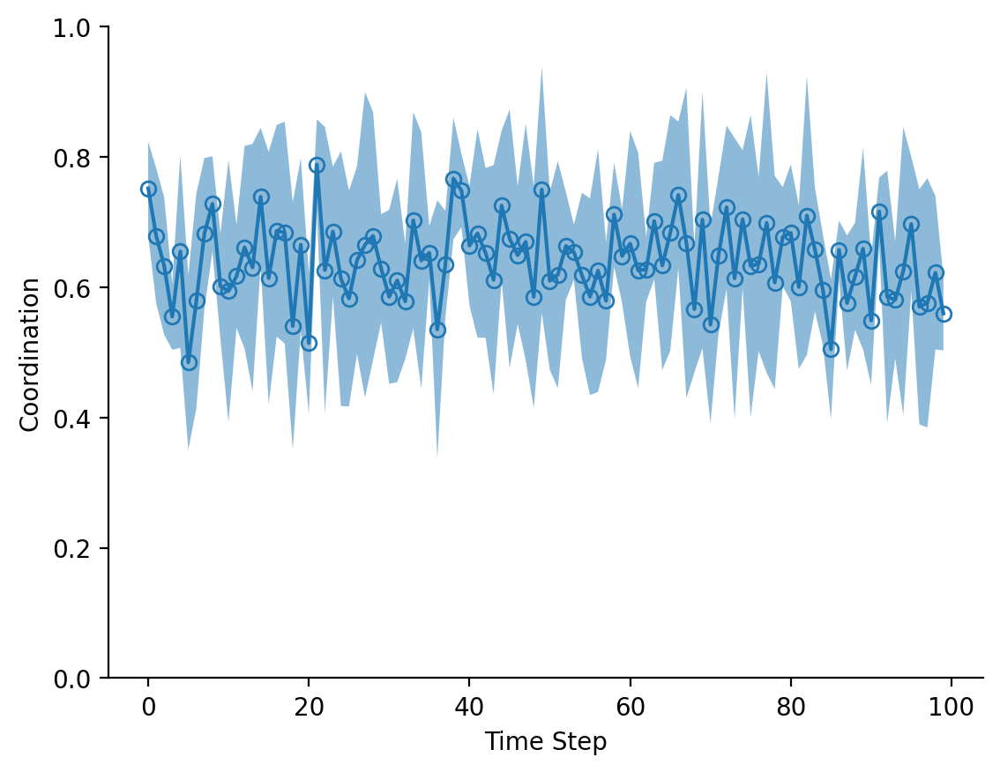

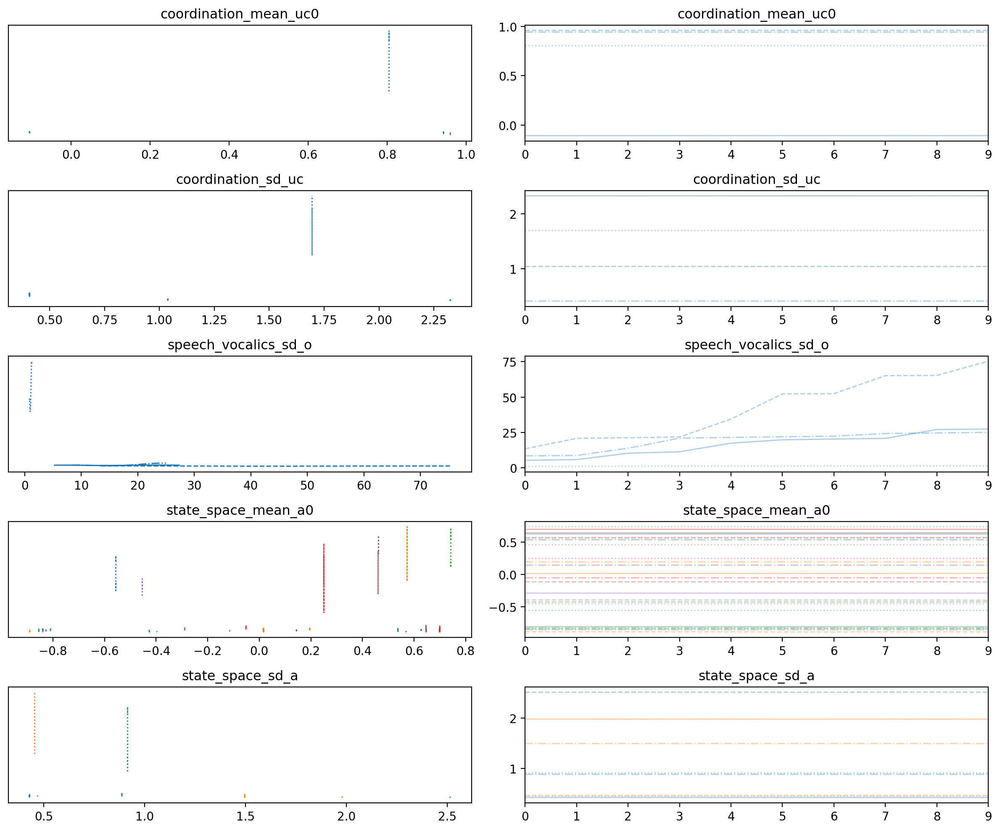

In [79]:
model.observation_normalization = "norm_per_feature"
model.config_bundle.sd_a = None
model.config_bundle.sd_o = None
model.config_bundle.mean_a0 = None
model.config_bundle.mean_uc0 = None
model.config_bundle.sd_uc = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit(burn_in=10, num_samples=10)
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, state_space_to_speech_vocalics_mlp_weights_in, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 4327 seconds.


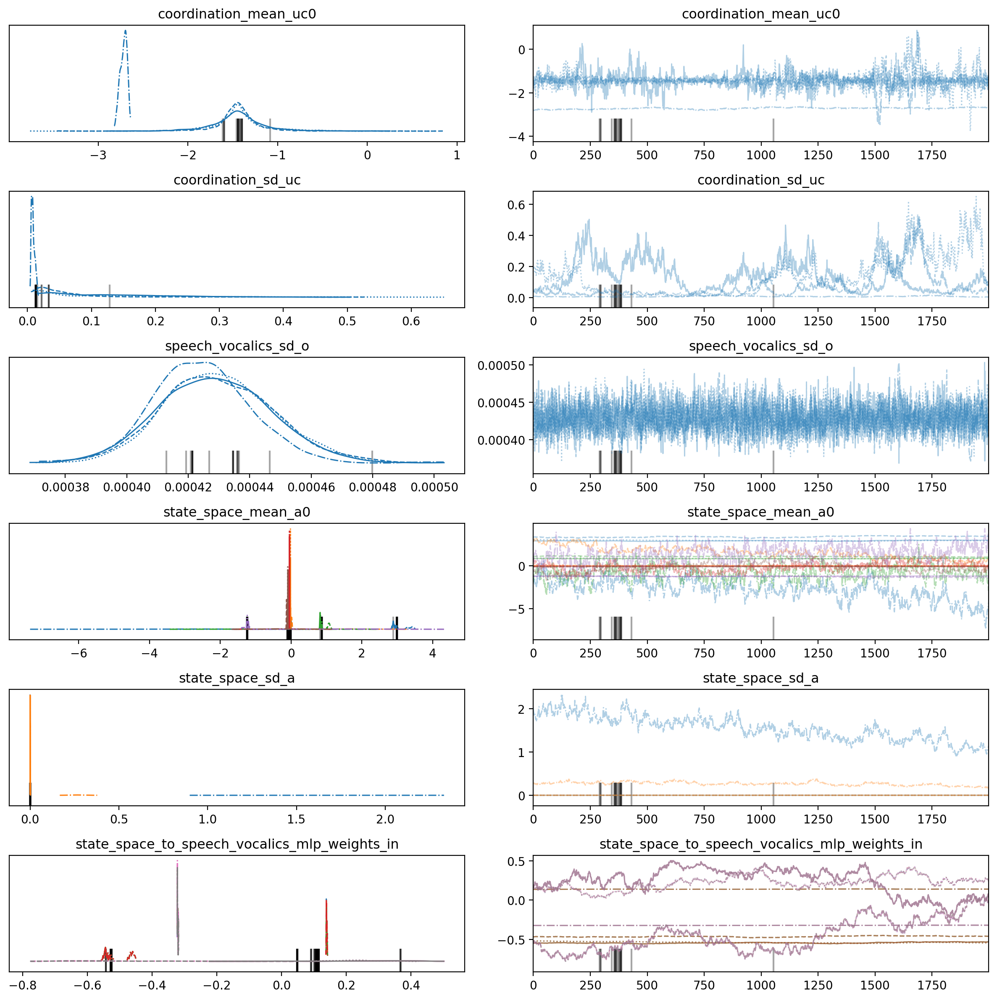

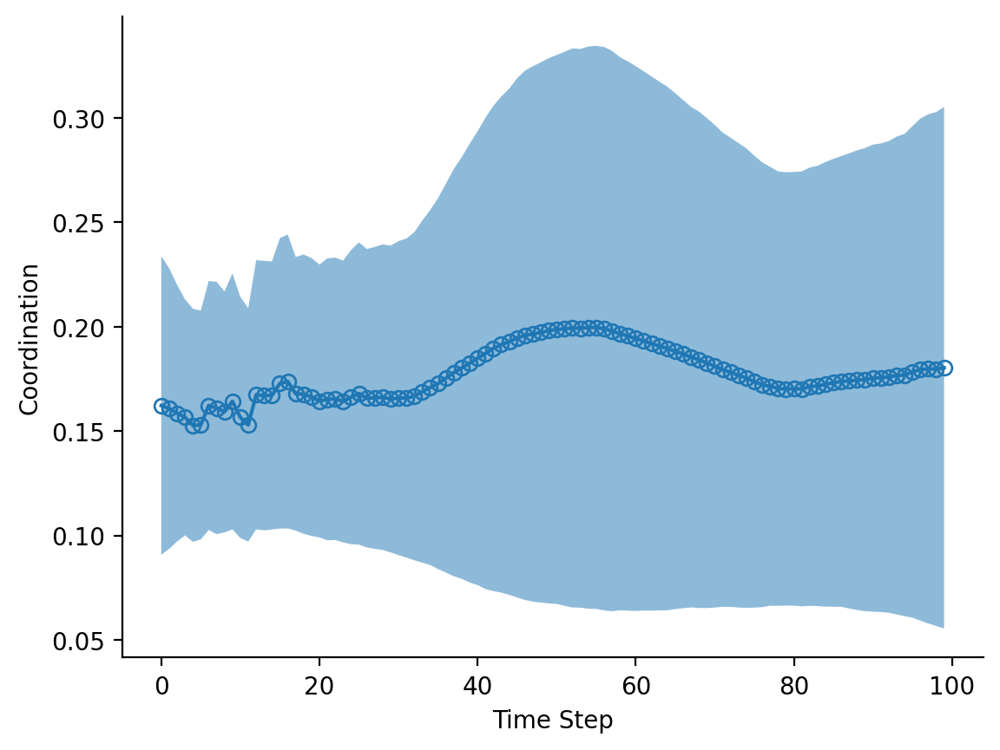

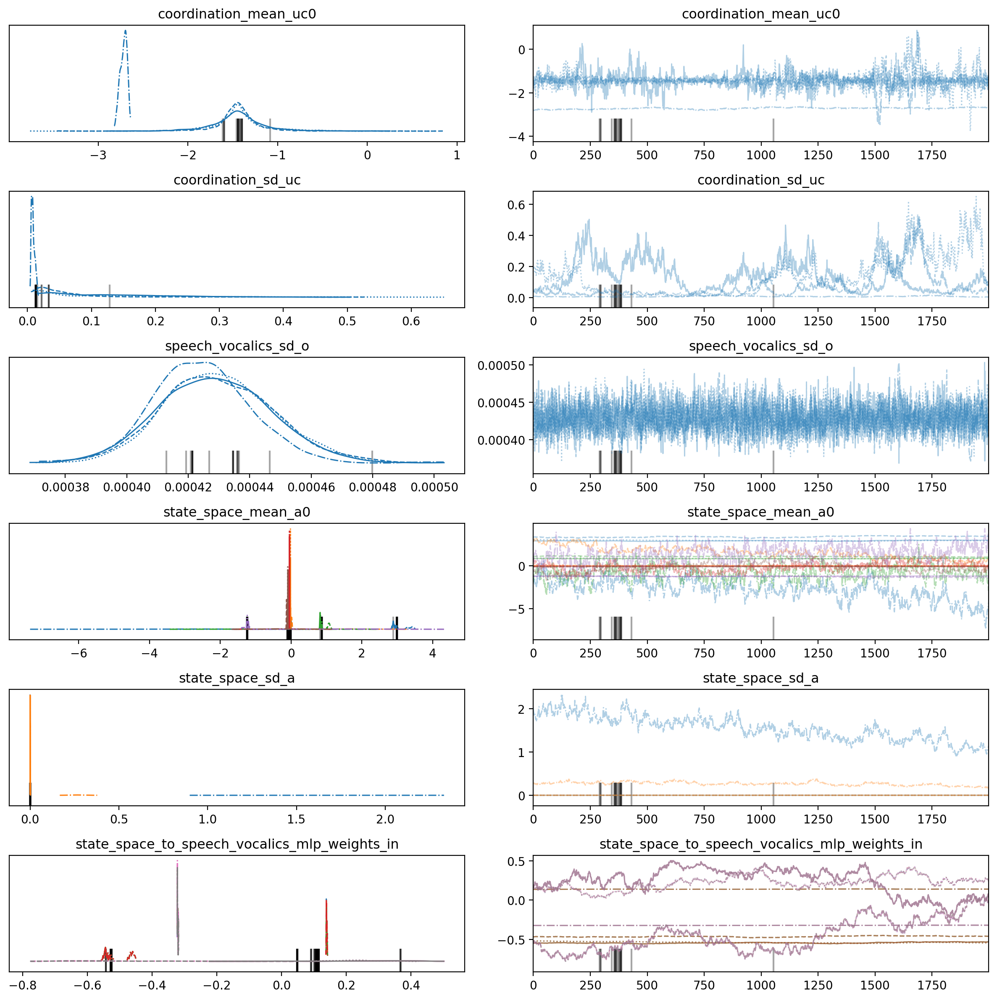

In [24]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = "norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0]
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None
bundle.weights = [None]
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit()
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 637 seconds.


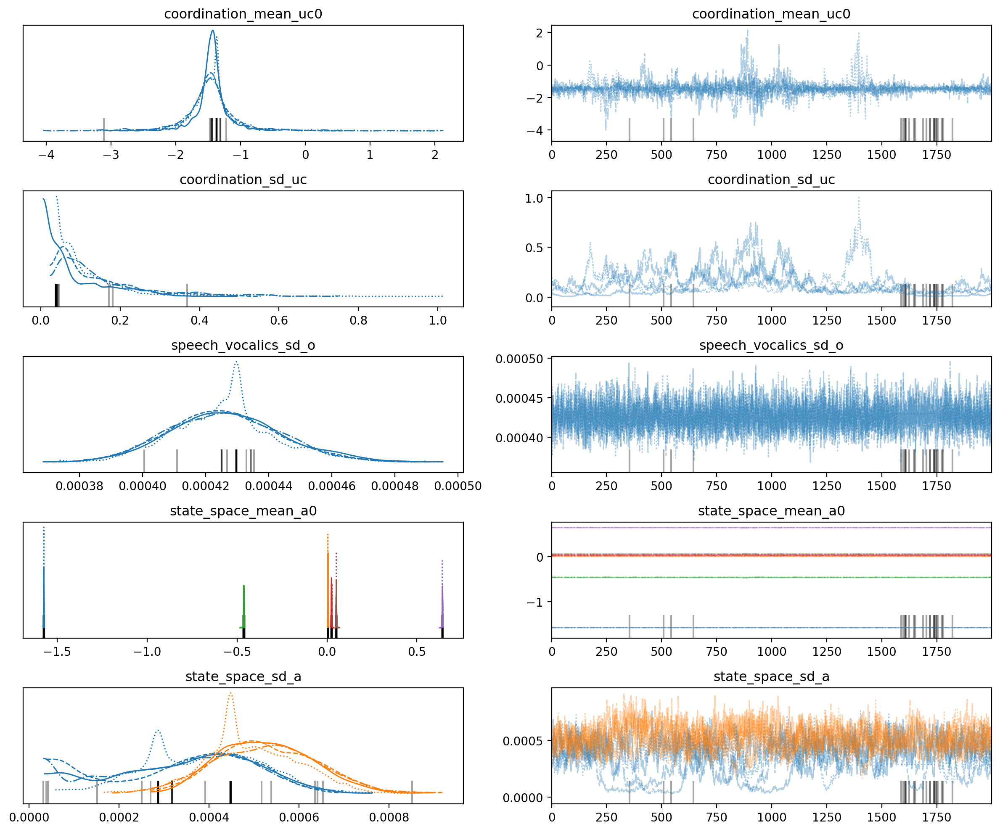

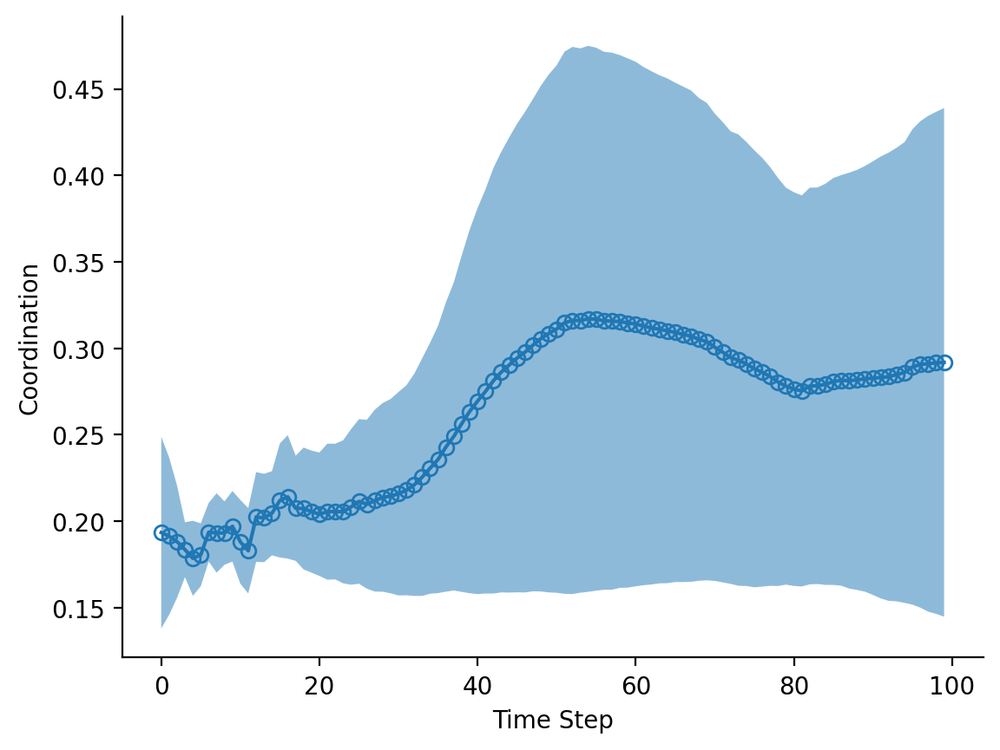

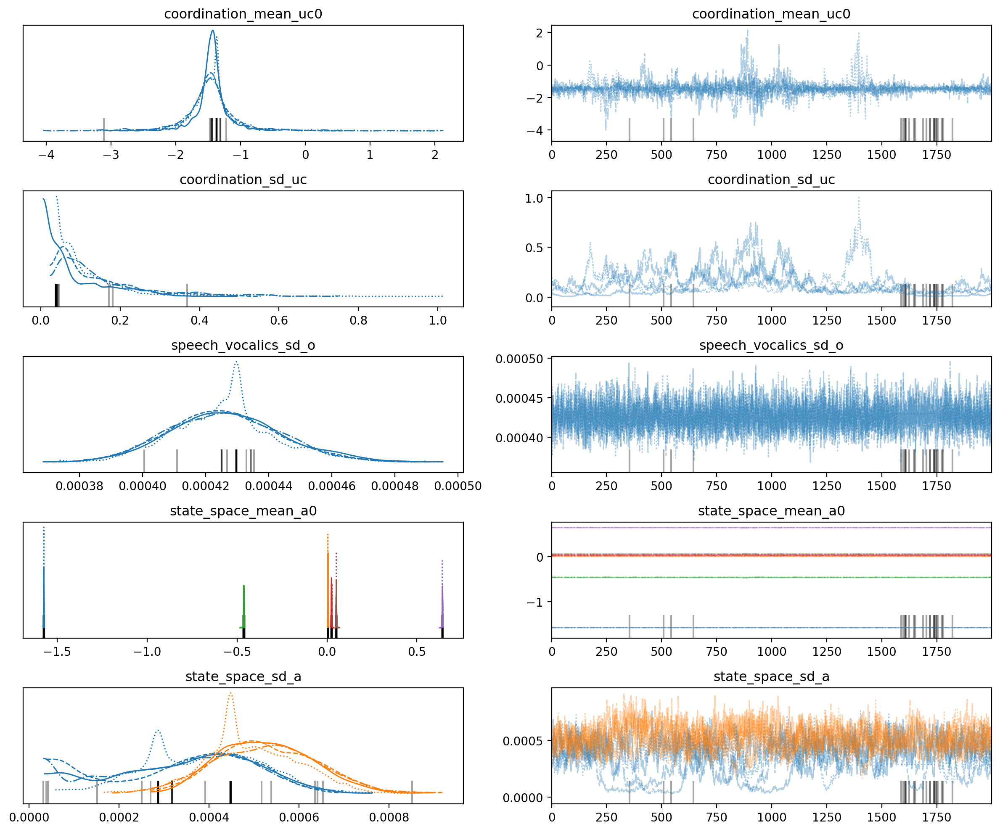

In [25]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = "norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0]
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit(burn_in=4000)
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [unbounded_coordination, state_space_mean_a0, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 166 seconds.


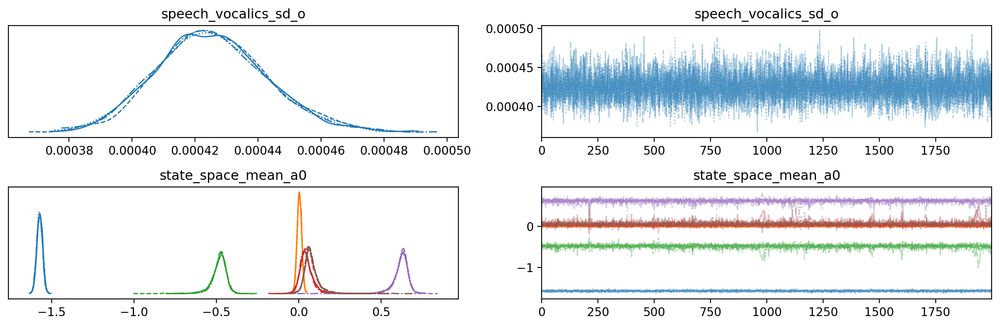

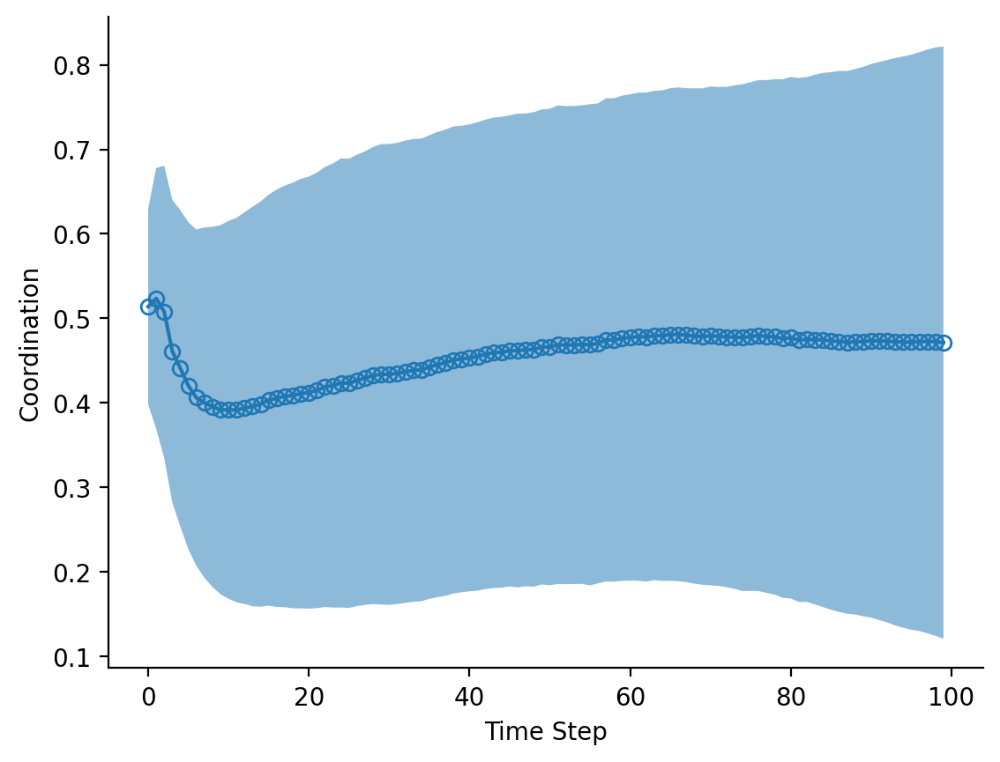

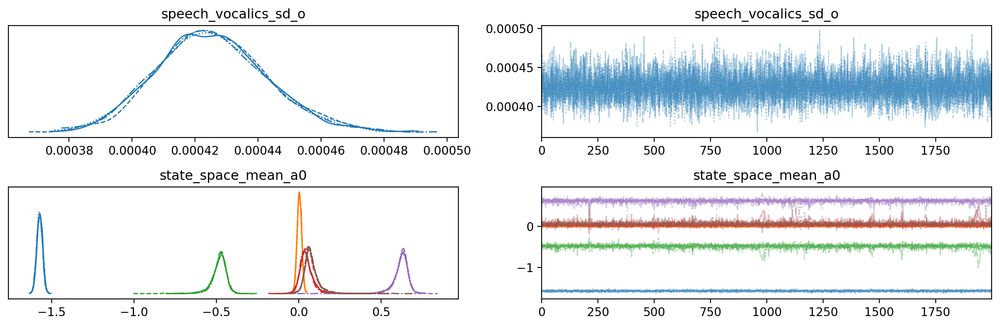

In [26]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = "norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0]
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
# bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
# bundle.mean_uc0 = None
# bundle.sd_uc = None
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit()
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, state_space_to_speech_vocalics_mlp_weights_in, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 4_000 tune and 2_000 draw iterations (16_000 + 8_000 draws total) took 3298 seconds.


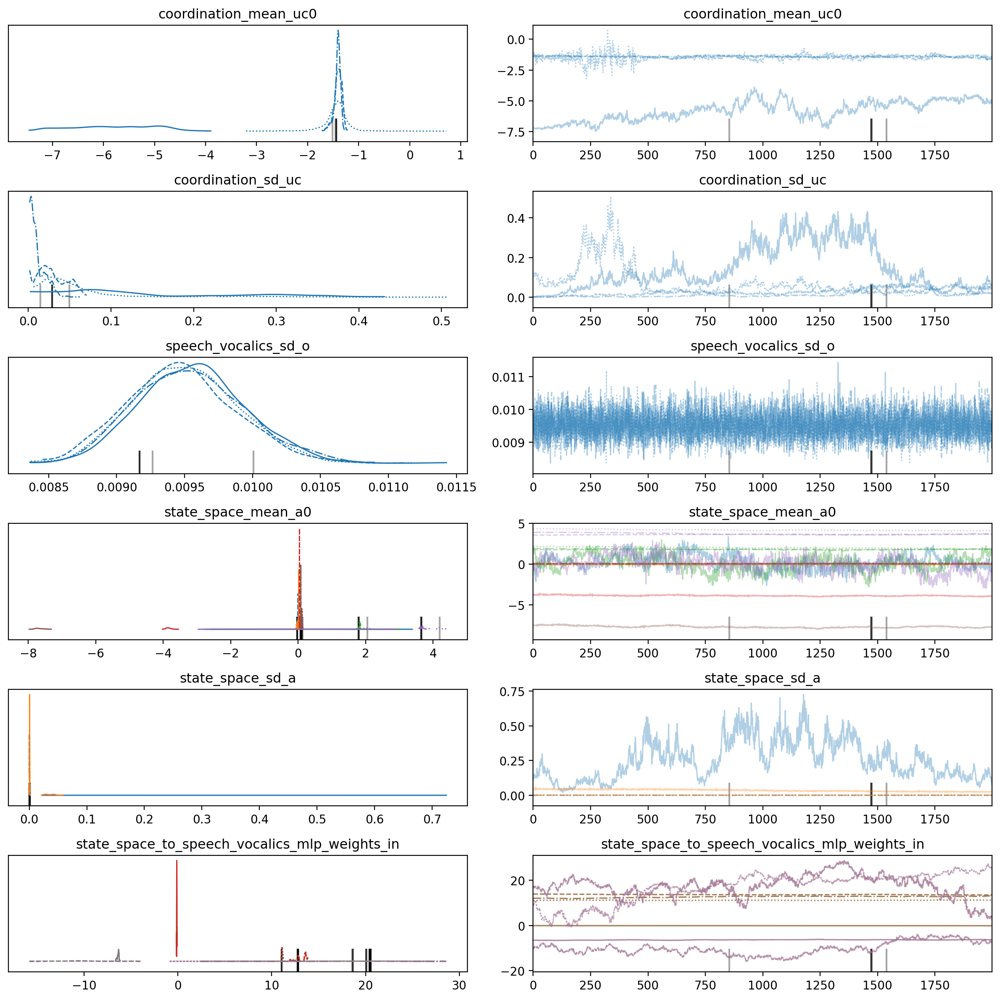

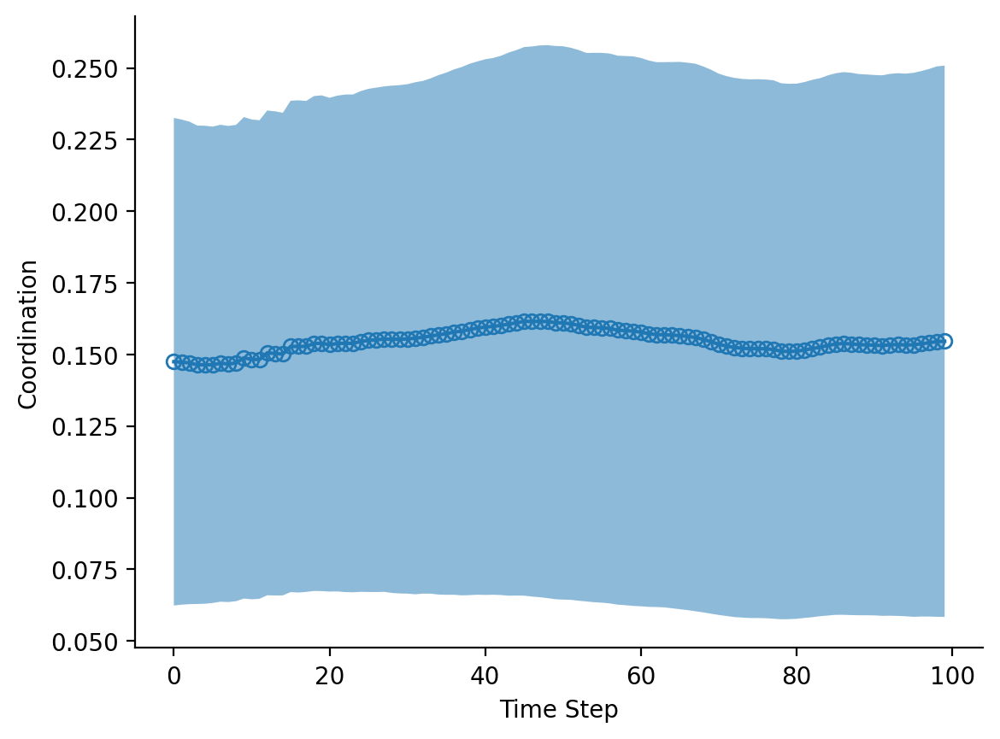

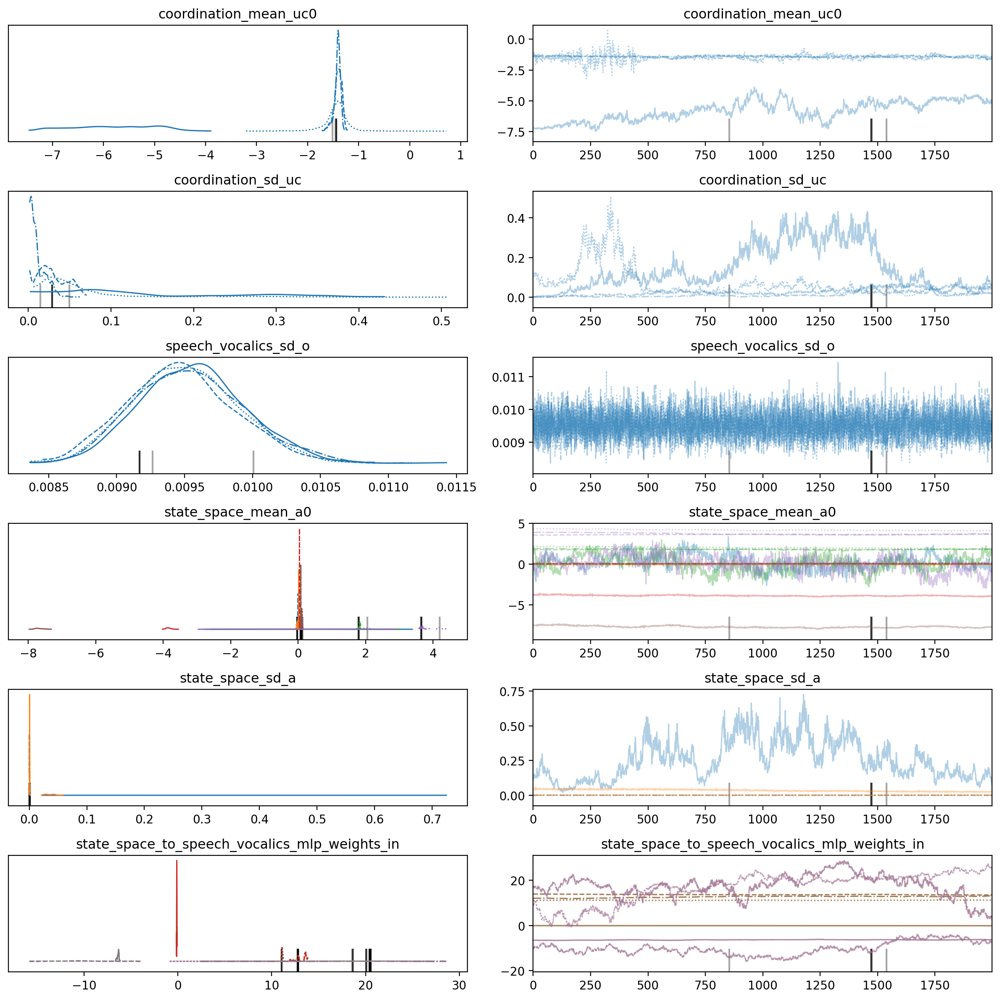

In [27]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
# bundle.observation_normalization = "norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.sd_w0 = 50
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0]
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None
bundle.weights = [None]
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit(burn_in=4000)
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [coordination_mean_uc0, coordination_sd_uc, unbounded_coordination, state_space_mean_a0, state_space_sd_a, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 1081 seconds.


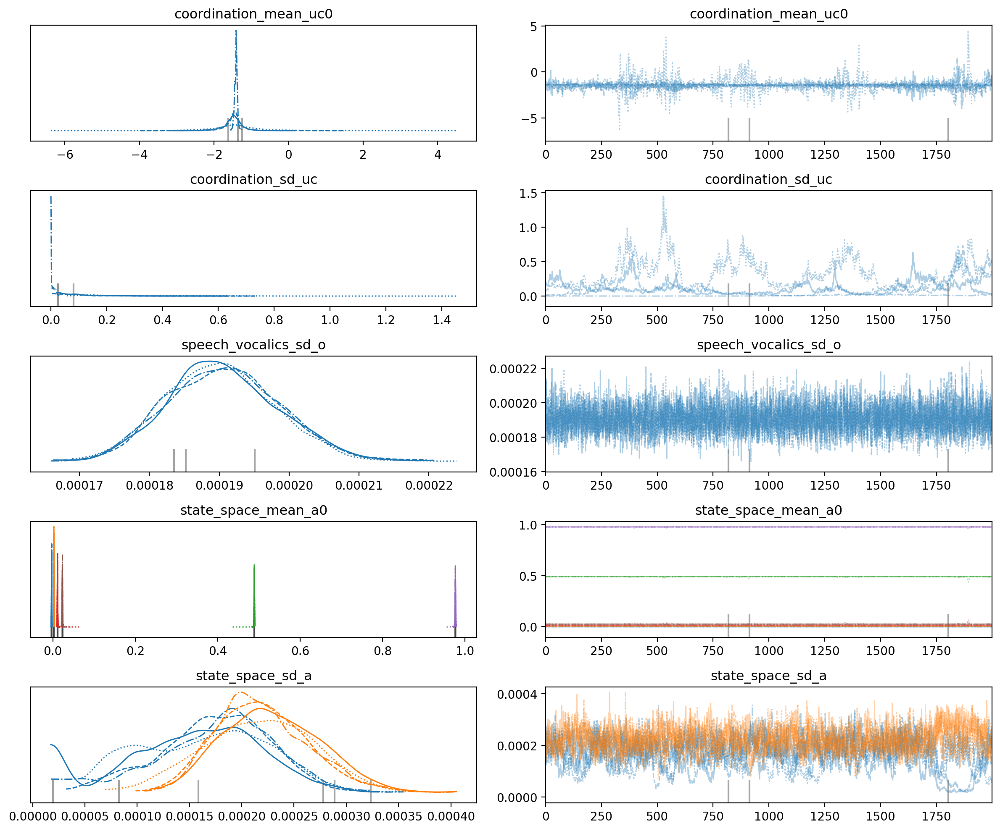

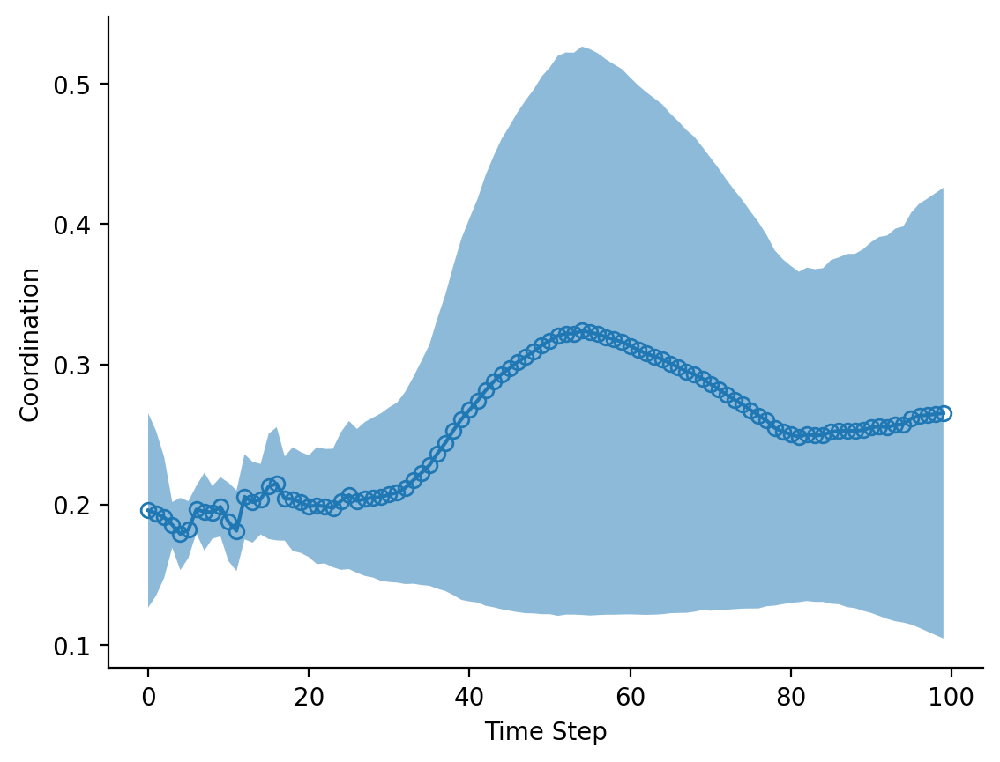

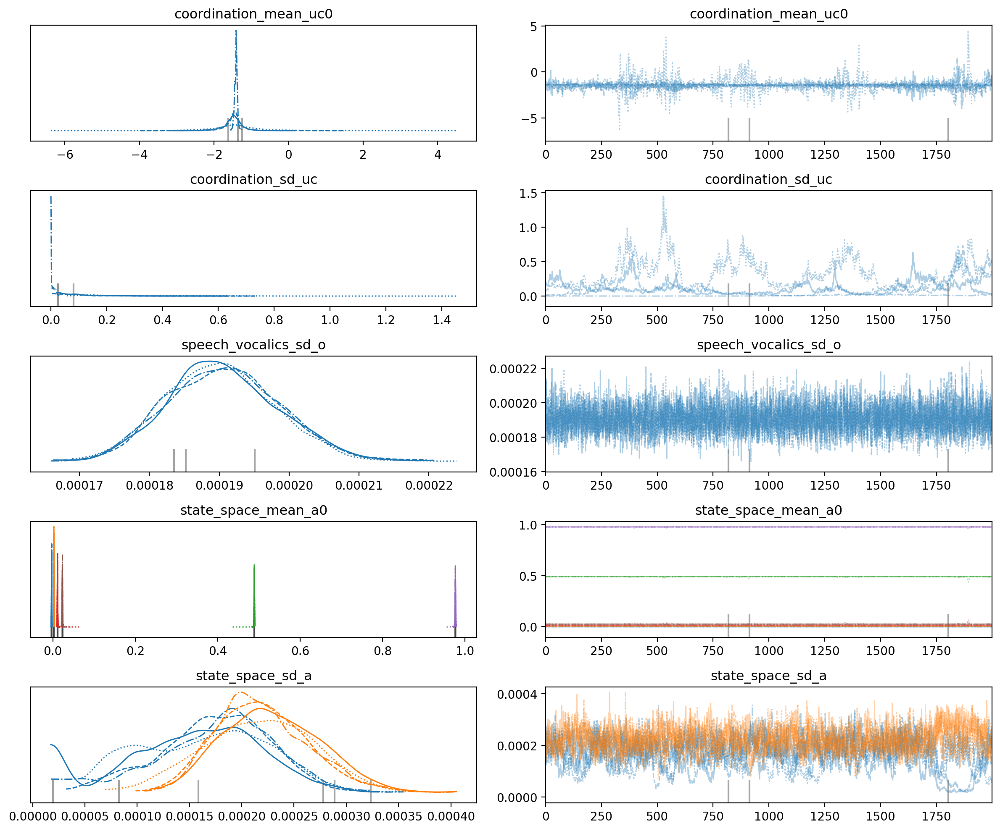

In [28]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = None#"norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0] / 50
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
bundle.mean_uc0 = None
bundle.sd_uc = None
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit()
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [unbounded_coordination, state_space_mean_a0, state_space, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 162 seconds.


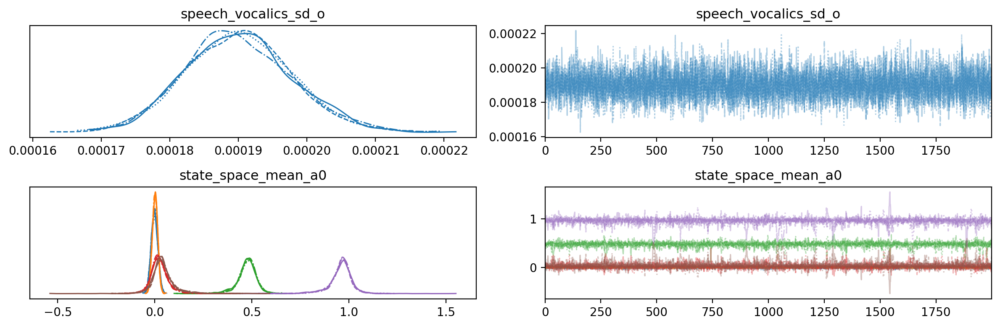

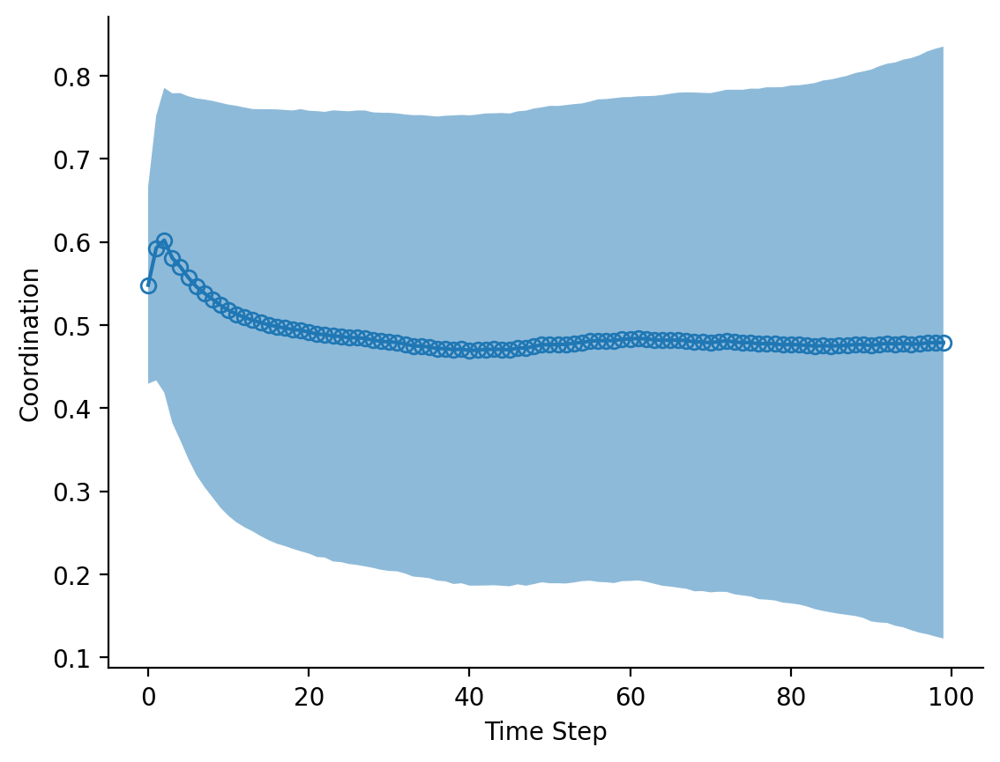

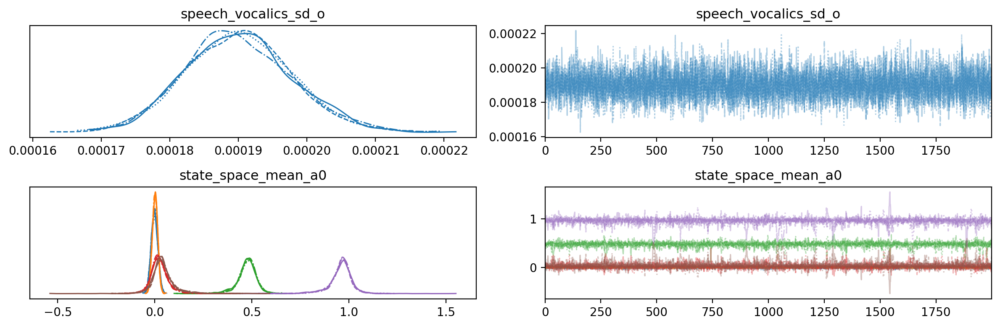

In [29]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = None #"norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0] / 50
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
# bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
# bundle.mean_uc0 = None
# bundle.sd_uc = None
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit()
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [unbounded_coordination, state_space_mean_a0, state_space, state_space_to_speech_vocalics_mlp_weights_in, speech_vocalics_sd_o]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 1855 seconds.


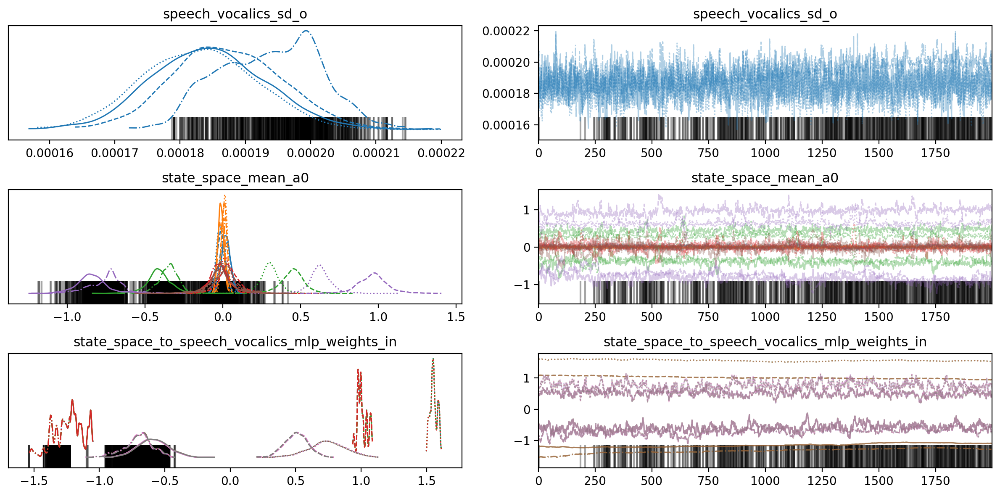

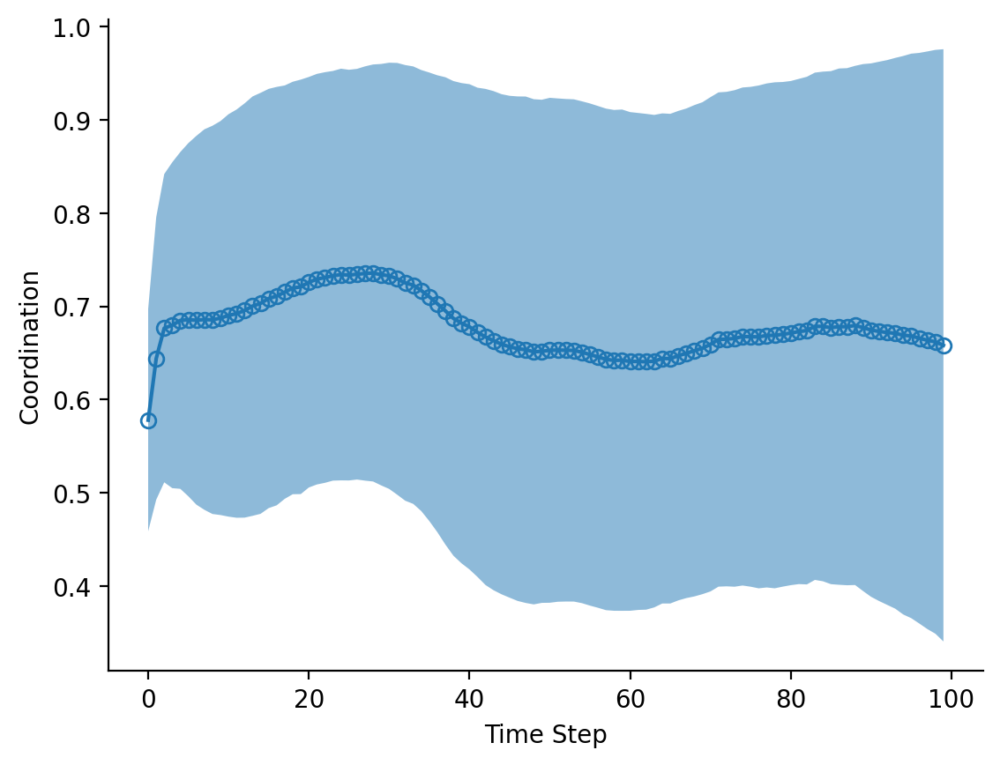

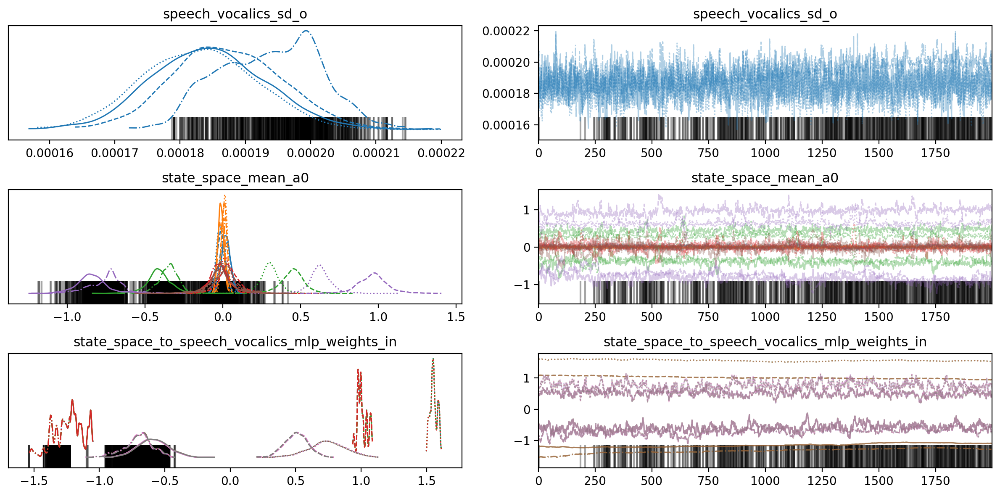

In [30]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = None #"norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0] / 50
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
# bundle.sd_a = None
bundle.sd_o = None
bundle.mean_a0 = None
# bundle.mean_uc0 = None
# bundle.sd_uc = None
# bundle.p = None
bundle.weights = [None]

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit()
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [unbounded_coordination, state_space_mean_a0, state_space]
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 4 chains for 2_000 tune and 2_000 draw iterations (8_000 + 8_000 draws total) took 225 seconds.


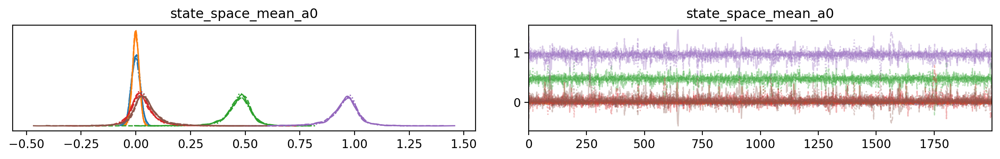

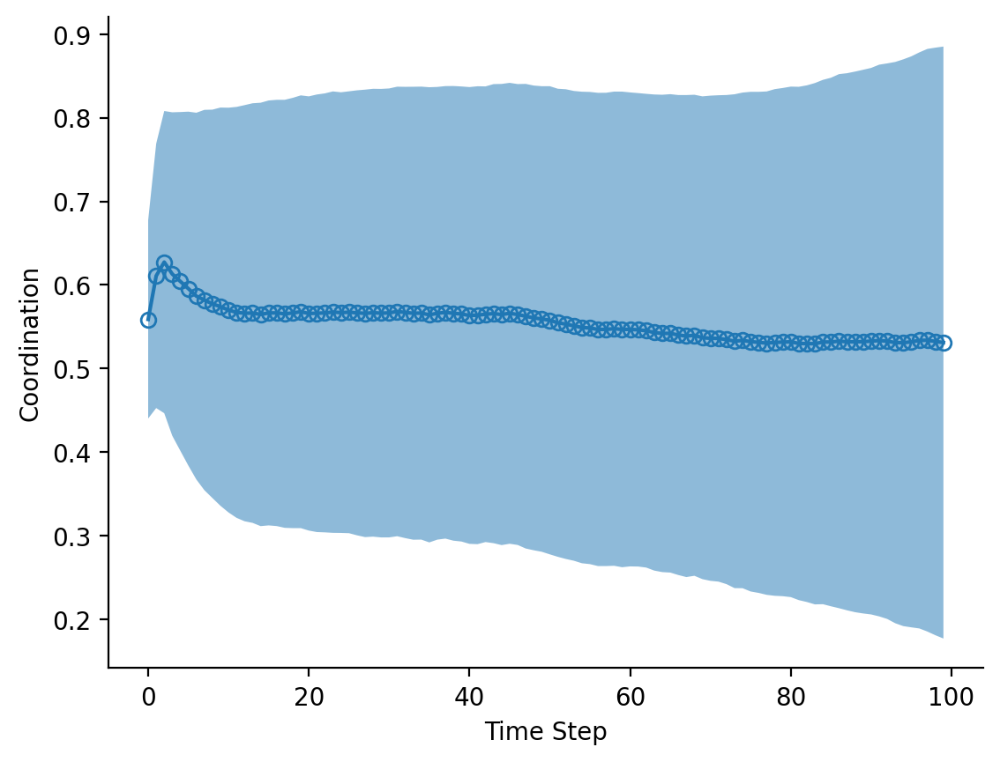

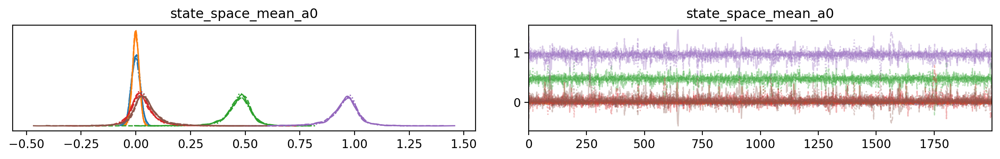

In [31]:
C = 0.2
T = 100
bundle = Vocalic2DConfigBundle()
# bundle = Vocalic2DSemanticLinkConfigBundle()
bundle.observation_normalization = None #"norm_per_feature"
bundle.num_time_steps_in_coordination_scale = T
# bundle.observation_dim_size = 1
bundle.mean_a0 = np.array([[0,0.1], [25,0.5], [50,1]])
bundle.sd_a = 0.01
bundle.sd_o = 0.01
bundle.coordination_samples = SigmoidGaussianCoordinationSamples(unbounded_coordination=None, coordination=np.ones((1,T)) * C)
model = VocalicModel(bundle)
# model = VocalicSemanticLinkModel(bundle)
model.prepare_for_sampling()
samples = model.draw_samples()

# Use samples from the observed vocalics for inference.
bundle.observed_values = samples.component_group_samples["speech_vocalics"].values[0] / 50
# bundle.observed_vocalic_values = samples.component_group_samples["speech_vocalics"].values[0]
bundle.subject_indices = samples.component_group_samples["speech_vocalics"].subject_indices[0]
bundle.prev_time_diff_subject = samples.component_group_samples["state_space"].prev_time_diff_subject[0]
bundle.prev_time_same_subject = samples.component_group_samples["state_space"].prev_time_same_subject[0]
bundle.time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.vocalics_time_steps_in_coordination_scale = samples.component_group_samples["speech_vocalics"].time_steps_in_coordination_scale[0]
# bundle.semantic_link_time_steps_in_coordination_scale = samples.component_group_samples["semantic_link"].time_steps_in_coordination_scale[0]

# Infer the parameters below as well
# bundle.sd_a = None
# bundle.sd_o = None
bundle.mean_a0 = None
# bundle.mean_uc0 = None
# bundle.sd_uc = None
# bundle.p = None

model.clear_parameter_values()
model.prepare_for_inference()
model.create_random_variables()
idata = model.fit()
idata.plot_time_series_posterior(variable_name="coordination", include_bands=True, value_bounds=(0, 1))
idata.plot_parameter_posterior()